In [1]:
#Importing the necessary libraries
import numpy as np
import cv2
from matplotlib import pyplot as plt
from sklearn.cluster import KMeans
from PIL import Image
import webcolors
from io import BytesIO
import math
import pandas as pd


#reading the images

images = []  
image_names = []

img_1 = cv2.imread('baboon.png')
baboon = cv2.cvtColor(img_1, cv2.COLOR_BGR2RGB)
images.append(baboon)
image_names.append('baboon')

img_2 = cv2.imread('landscape.jpg')
landscape = cv2.cvtColor(img_2, cv2.COLOR_BGR2RGB)
images.append(landscape)
image_names.append('landscape')


img_3 = cv2.imread('lenna.png')
lenna = cv2.cvtColor(img_3, cv2.COLOR_BGR2RGB)
images.append(lenna)
image_names.append('lenna')


img_4 = cv2.imread('peppers.png')
peppers = cv2.cvtColor(img_4, cv2.COLOR_BGR2RGB)
images.append(peppers)
image_names.append('peppers')


img_5 = cv2.imread('umbrella.png')
umbrella = cv2.cvtColor(img_5, cv2.COLOR_BGR2RGB)
images.append(umbrella)
image_names.append('umbrella')

In [2]:
#finding size of images
def image_size(image):
    image_file = BytesIO()
    img = Image.fromarray(image)
    img.save(image_file, 'png')
    return image_file.tell()/1024

orig_size = []
for image in images:
    orig_size.append(image_size(image))

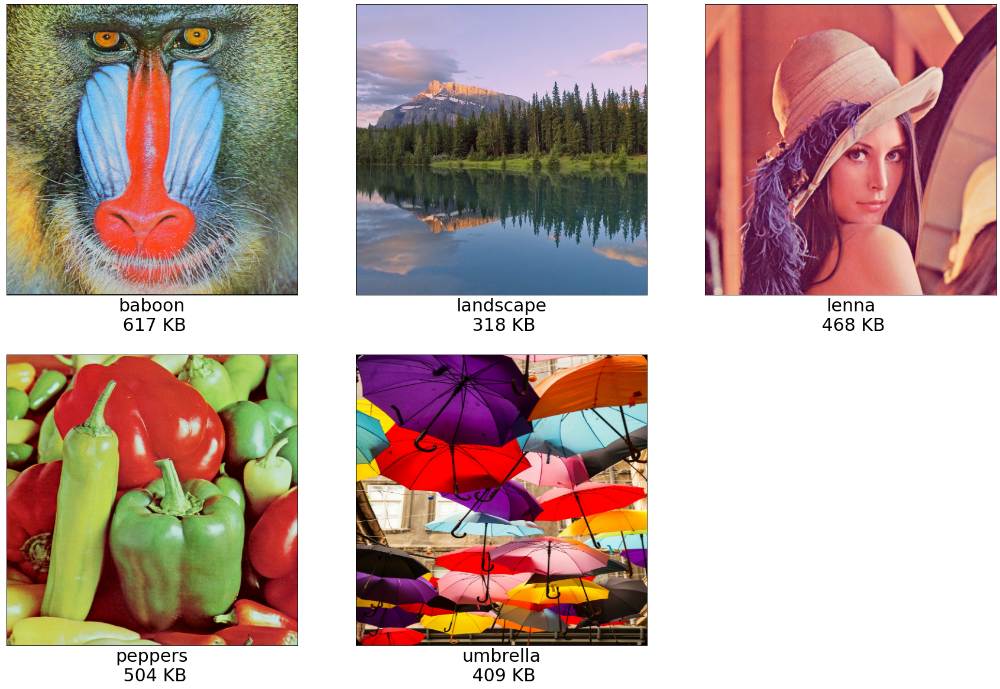

In [3]:
#Showing the original image before any compression
f, axarr = plt.subplots(2,3, figsize=(30,20)) 

for i in range(3):
    axarr[0][i].imshow(images[i])
    axarr[0][i].set_xticks([])
    axarr[0][i].set_yticks([])
    axarr[0][i].set_xlabel(f"{image_names[i]}\n {int(orig_size[i])} KB", fontsize=30)
for j in range(2):
    axarr[1][j].imshow(images[j+3])
    axarr[1][j].set_xticks([])
    axarr[1][j].set_yticks([])
    axarr[1][j].set_xlabel(f"{image_names[j+3]}\n {int(orig_size[j+3])} KB", fontsize=30)
axarr.flat[-1].set_visible(False) # to remove last plot

In [4]:
#Finding the type how images are stored
a = 0
for image in images:
    print(type(images[a]))
    a = a + 1

<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>
<class 'numpy.ndarray'>


In [5]:
#Having a sight how data is stored in this notebook by showing 9 pixels from a 3x3 square on upper left corner
images[0][:3,:3]

array([[[164, 150,  71],
        [ 63,  57,  31],
        [ 75,  43,  10]],

       [[120, 125,  62],
        [135,  97,  33],
        [ 55,  35,  23]],

       [[ 99,  74,  31],
        [132, 118,  46],
        [ 60,  41,  36]]], dtype=uint8)

In [6]:
#before resizing it's good to see the original dimension of all images
a = 0
for image in images:
    print("Shape of the image", image_names[a],":", np.shape(image))
    a = a + 1


Shape of the image baboon : (512, 512, 3)
Shape of the image landscape : (512, 512, 3)
Shape of the image lenna : (512, 512, 3)
Shape of the image peppers : (512, 512, 3)
Shape of the image umbrella : (512, 512, 3)


In [7]:
reshaped_images = []
for image in images:
    img = image.reshape(-1, image.shape[2])
    reshaped_images.append(img)
    print(img.shape)

(262144, 3)
(262144, 3)
(262144, 3)
(262144, 3)
(262144, 3)


In [8]:
a = 0
for image in reshaped_images:
    counter = np.unique(image, axis=0)
    print ("Number of unique colors in image",image_names[a],"is",counter.shape[0])
    a = a + 1

Number of unique colors in image baboon is 230427
Number of unique colors in image landscape is 57600
Number of unique colors in image lenna is 148279
Number of unique colors in image peppers is 183525
Number of unique colors in image umbrella is 135560


In [9]:
#Re-size the images to 256x256x3 dimension
a = 0
for image in images:
    images[a] = cv2.resize(image, (256, 256))
    print("Shape of the image ", image_names[a],":", np.shape(images[a]))
    a = a + 1

Shape of the image  baboon : (256, 256, 3)
Shape of the image  landscape : (256, 256, 3)
Shape of the image  lenna : (256, 256, 3)
Shape of the image  peppers : (256, 256, 3)
Shape of the image  umbrella : (256, 256, 3)


In [10]:
#Calculating image size in bytes for reduced size
reduced_size = []
for image in images:
    reduced_size.append(image_size(image))

orig_size = reduced_size

In [11]:
#Reshaping the image array into 2D array

reshaped_images = []
for image in images:
    img = image.reshape(-1, image.shape[2])
    reshaped_images.append(img)
    print(img.shape)

(65536, 3)
(65536, 3)
(65536, 3)
(65536, 3)
(65536, 3)


In [12]:
#Calculating unique colors in 256x256 images
a = 0
for image in reshaped_images:
    counter = np.unique(image, axis=0)
    print ("Number of unique colors in image",image_names[a],"is",counter.shape[0])
    a = a + 1

Number of unique colors in image baboon is 62070
Number of unique colors in image landscape is 33194
Number of unique colors in image lenna is 48331
Number of unique colors in image peppers is 54108
Number of unique colors in image umbrella is 45085


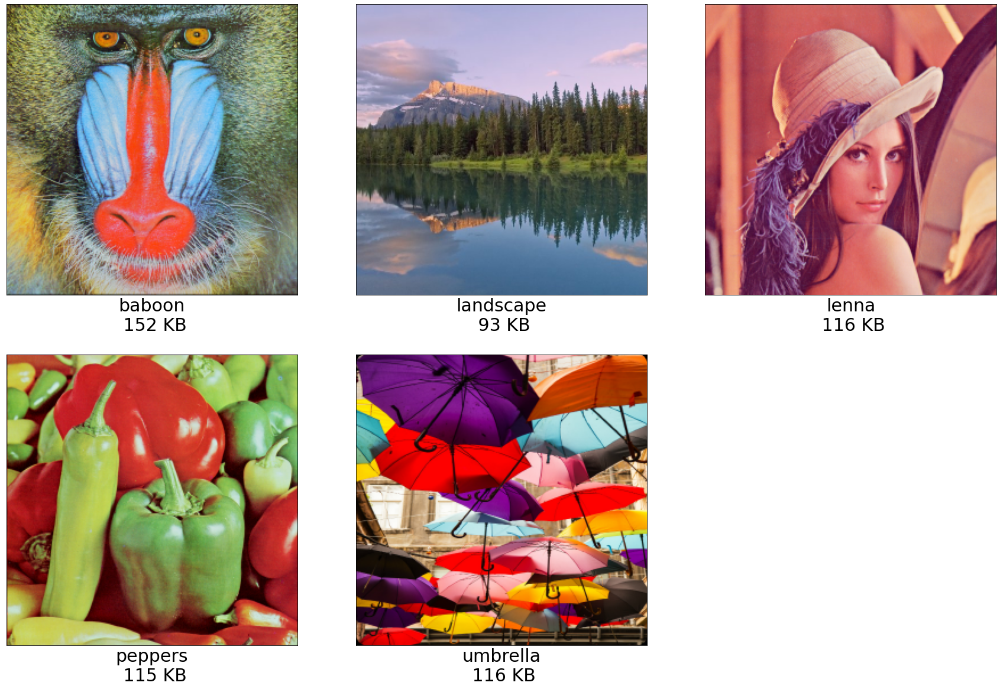

In [13]:
#Showing the resized images, see if they become smaller
f, axarr = plt.subplots(2,3, figsize=(30,20)) 

for i in range(3):
    axarr[0][i].imshow(images[i])
    axarr[0][i].set_xticks([])
    axarr[0][i].set_yticks([])
    axarr[0][i].set_xlabel(f"{image_names[i]}\n {int(reduced_size[i])} KB", fontsize=30)
for j in range(2):
    axarr[1][j].imshow(images[j+3])
    axarr[1][j].set_xticks([])
    axarr[1][j].set_yticks([])
    axarr[1][j].set_xlabel(f"{image_names[j+3]}\n {int(reduced_size[j+3])} KB", fontsize=30)
axarr.flat[-1].set_visible(False) # to remove last plot

In [14]:
#Defining K-Means Loop function

def kmeans_loop(reshaped_img, clusters):
    kmeans_args={"init":"k-means++", "n_init":10,  "max_iter":300, "random_state":42}
    kmeans=KMeans(n_clusters=clusters, **kmeans_args)
    kmeans.fit(reshaped_img)
    return kmeans
    
#Starting K-Means for baboon image

kmeans_arr_1 = [] 

for i in range(1,9):
    kmeans_arr_1.append(kmeans_loop(reshaped_images[0], 2**i))



In [15]:
#Re-assigning each pixel value as the closest center to it
def pixels_as_centroids(kmeans, typ, reshape):

    if(typ):
    #Removing decimals from centroid values
        centroids  = kmeans.cluster_centers_.astype("uint8")
    else:
        centroids  = kmeans.cluster_centers_
    compd_img = np.array([list(centroids[label]) for label in kmeans.labels_])
    if (reshape):
        # reshape the array with centroids 
        compd_img = np.reshape(compd_img, (256, 256, 3), "C")
    return compd_img

compd_img_1 = []
compd_img3D_1 = []
compd_img3D_size_1 = []

for kmeans in kmeans_arr_1:
    compd_img3D_1.append(pixels_as_centroids(kmeans, True, True))
    compd_img_1.append(pixels_as_centroids(kmeans, False, False))

for image in compd_img3D_1:
    compd_img3D_size_1.append(int(image_size(image)))

In [16]:
#Method for calculating WCSS (Within Cluster Sum of Squares)

def wcss(compd, reshaped):
    wcss = 0
    for i in range(compd.shape[0]):
        for j in range(compd.shape[1]):
            wcss = wcss + (compd[i][j] - reshaped[i][j])**2
    return wcss

#Calculating WCSS of each compressed image
wcss_1 = []
for i in range(8):
    wcss_1.append(wcss(compd_img_1[i], reshaped_images[0]))

wcss_1

[303687371.1103603,
 123324556.95263703,
 63295988.44706602,
 34269082.08453793,
 19397631.331219822,
 11790943.563940592,
 7432198.560672264,
 4710510.155055794]

In [17]:
#Calculating elbow point for each sse type metric
def elbow_sse(wcss):
    begin = (2, wcss[0])
    end = (256, wcss[-1])

    m = (end[1] - begin[1]) / (end[0] - begin[0])
    c = (end[1]- (m*end[0]))

    dist = []
    for i in range(1,9):
        dist.append((abs(m*(2**i) - wcss[i-1] + c))/math.sqrt(m**2 + 1))
    return 2**(dist.index(max(dist)) + 1)

elbow_sse(wcss_1)

16

In [18]:
#Calculating BCSS for each compressed image
def bcss(kmeans, image):
    a, label_counts = np.unique(kmeans.labels_, return_counts = True)
    sum_sq = np.sum(np.square(kmeans.cluster_centers_ - np.mean(image, axis=0)), axis=1)
    bcss = 0
    for i in range(label_counts.shape[0]):
        bcss = bcss + label_counts[i] * sum_sq[i]
    return bcss
bcss_1 = []
for i in range(8):
    bcss_1.append(bcss(kmeans_arr_1[i], reshaped_images[0]))
bcss_1

[230953996.91206533,
 411179924.81784713,
 471046867.13104284,
 500086856.3252734,
 515007597.8204001,
 522510192.81434923,
 526790932.5881632,
 529574118.96629053]

In [19]:
#Calculating Explained Variance (Silhouette Score)
sil_score_1 = []
for i in range(8):
    sil_score_1.append(bcss_1[i] / (wcss_1[i] + bcss_1[i]))
sil_score_1

[0.43197928691215287,
 0.7692731096582414,
 0.8815442411434776,
 0.9358684359595232,
 0.9637023923549289,
 0.9779320260408496,
 0.9860878383444582,
 0.9911835192361749]

In [20]:
#Function for getting the closest colour
def closest_colour(requested_colour):
    min_colours = {}
    for key, name in webcolors.CSS3_HEX_TO_NAMES.items():
        red, green, blue = webcolors.hex_to_rgb(key)
        r_d = (red - requested_colour[0]) ** 2
        g_d = (green - requested_colour[1]) ** 2
        b_d = (blue - requested_colour[2]) ** 2
        min_colours[(r_d + g_d + b_d)] = name
    return min_colours[min(min_colours.keys())]

def get_colour_name(requested_colour):
    try:
        closest_name = actual_name = webcolors.rgb_to_name(requested_colour)
    except ValueError:
        closest_name = closest_colour(requested_colour)
    return closest_name

colors_1 = []

for i in range(8):
    colors = [] 
    for center in kmeans_arr_1[i].cluster_centers_:
        colors.append(get_colour_name(center.tolist()))
    colors_1.append(colors)



<Figure size 432x288 with 0 Axes>

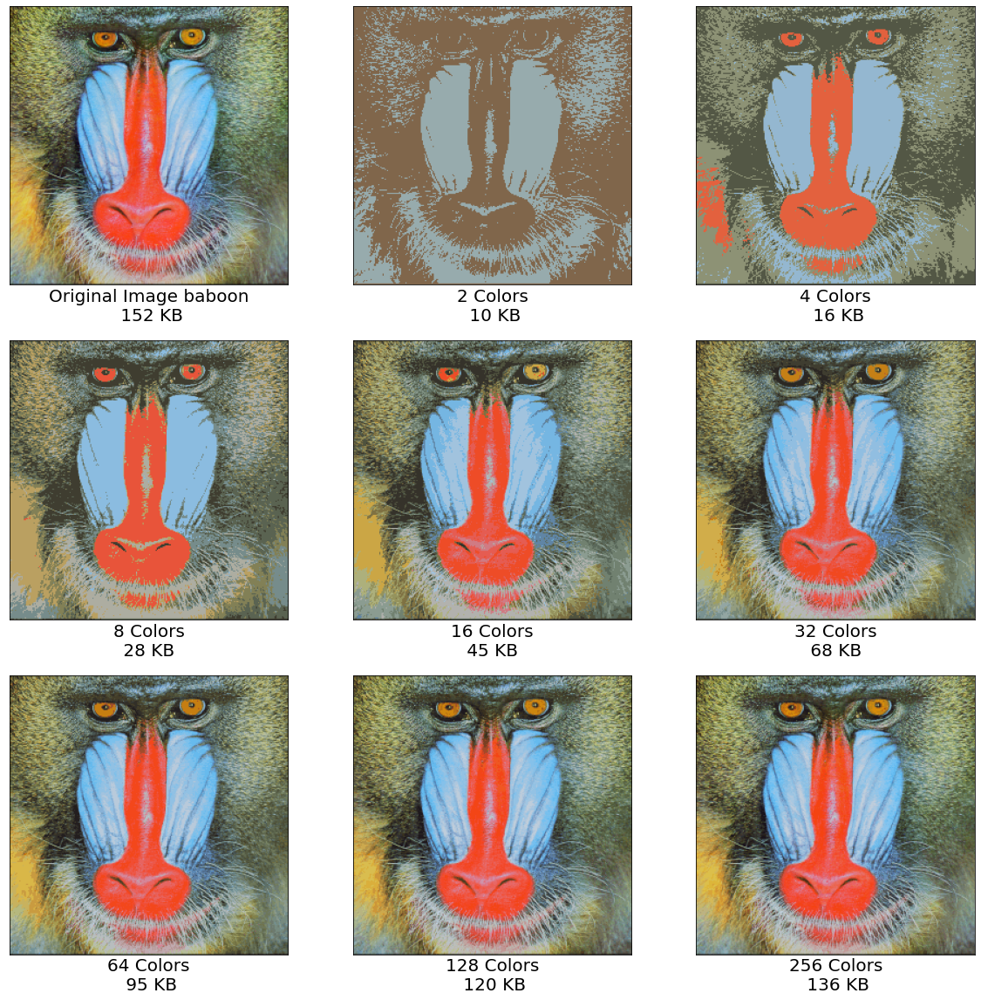

In [21]:
#Showing each compressed image
plt.figure()
f, axarr = plt.subplots(3,3, figsize=(20,20)) 
axarr[0][0].imshow(images[0])
axarr[0][0].set_xticks([])
axarr[0][0].set_yticks([])
axarr[0][0].set_xlabel(f"Original Image {image_names[0]}\n {int(orig_size[0])} KB", fontsize=20)


for j in range(1,3):
    compressed = Image.fromarray(compd_img3D_1[j-1])

    axarr[0][j].imshow(compressed)
    axarr[0][j].set_xticks([])
    axarr[0][j].set_yticks([])
    axarr[0][j].set_xlabel(f"{2**j} Colors\n {compd_img3D_size_1[j-1]} KB", fontsize=20)

for k in range (3,6):
    compressed = Image.fromarray(compd_img3D_1[k-1])

    axarr[1][k-3].imshow(compressed)
    axarr[1][k-3].set_xticks([])
    axarr[1][k-3].set_yticks([])
    axarr[1][k-3].set_xlabel(f"{2**k} Colors\n {compd_img3D_size_1[k-1]} KB ", fontsize=20)

for l in range(6,9):
    compressed = Image.fromarray(compd_img3D_1[l-1])

    axarr[2][l-6].imshow(compressed)
    axarr[2][l-6].set_xticks([])
    axarr[2][l-6].set_yticks([])
    axarr[2][l-6].set_xlabel(f"{2**l} Colors\n {compd_img3D_size_1[l-1]} KB", fontsize=20)



In [22]:
#Constructing a data frame for metric for each compressed image

cols = ["# Clusters", "Used Color Names","WCSS", "BCSS", "Explained Variance", "Image Size (KB)"]

data_1 = []

for i in range(8):
    data_1.append([len(kmeans_arr_1[i].cluster_centers_), colors_1[i], wcss_1[i], bcss_1[i], sil_score_1[i], compd_img3D_size_1[i]])
df = pd.DataFrame(data_1, columns = cols)

df

,# Clusters,Used Color Names,WCSS,BCSS,Explained Variance,Image Size (KB)
0,2,"[dimgray, darkgray]",3.036874e+08,2.309540e+08,0.431979,10
1,4,"[lightsteelblue, darkolivegreen, gray, tomato]",1.233246e+08,4.111799e+08,0.769273,16
2,8,"[dimgray, darkgray, dimgray, tomato, darkkhaki...",6.329599e+07,4.710469e+08,0.881544,28
3,16,"[darkolivegreen, darkkhaki, gray, lightsteelbl...",3.426908e+07,5.000869e+08,0.935868,45
4,32,"[darkgray, darkolivegreen, sienna, dimgray, sk...",1.939763e+07,5.150076e+08,0.963702,68
5,64,"[dimgray, darkseagreen, tomato, darkgray, dimg...",1.179094e+07,5.225102e+08,0.977932,95
6,128,"[dimgray, skyblue, darkolivegreen, tomato, dar...",7.432199e+06,5.267909e+08,0.986088,120
7,256,"[chocolate, slategray, skyblue, dimgray, darkk...",4.710510e+06,5.295741e+08,0.991184,136


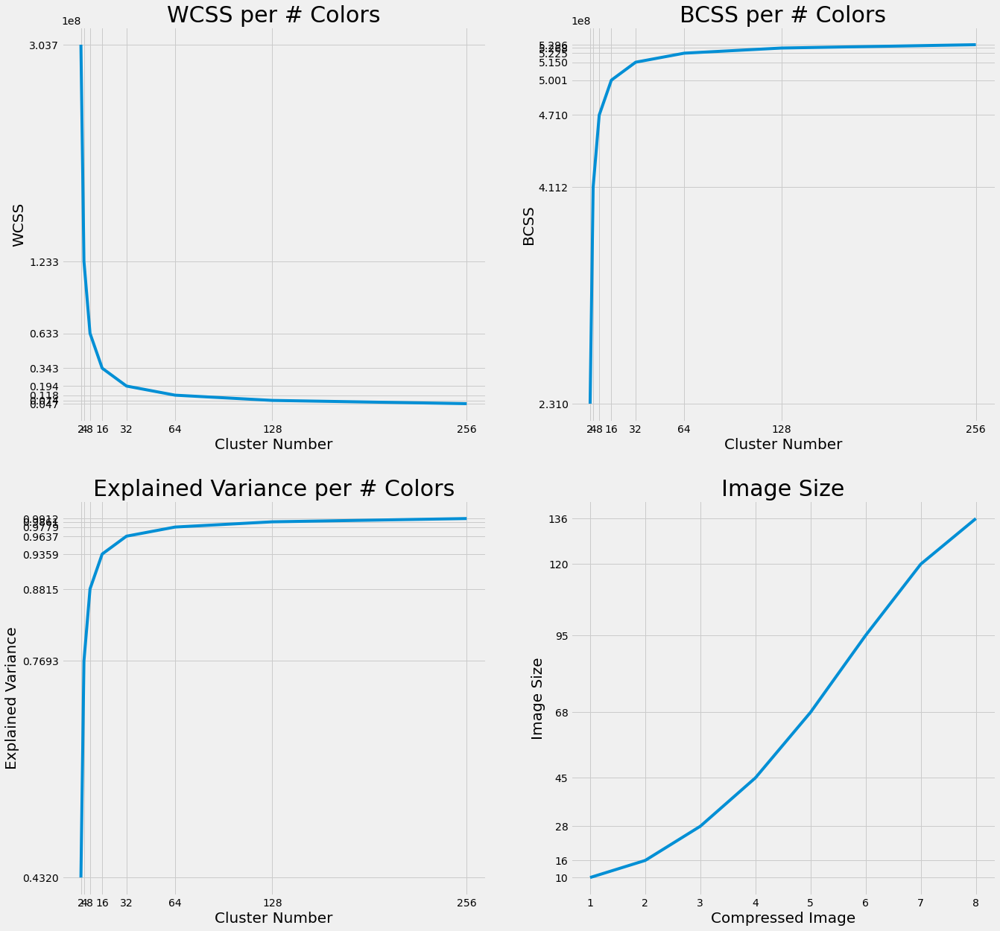

In [23]:
#Plotting Metrics for baboon (WCSS, BCSS, Explained Variance, Image Size)
plt.style.use("fivethirtyeight")

f, axarr = plt.subplots(2,2, figsize=(20,20)) 

squared = []
for i in range(1,9):
    squared.append(2**i)
axarr[0][0].plot(squared, wcss_1)
axarr[0][0].set_xticks(squared)
axarr[0][0].set_yticks(wcss_1)
axarr[0][0].set_title("WCSS per # Colors", fontsize=30)
axarr[0][0].set_xlabel("Cluster Number", fontsize=20)
axarr[0][0].set_ylabel("WCSS", fontsize=20)
axarr[0][1].plot(squared, bcss_1)
axarr[0][1].set_xticks(squared)
axarr[0][1].set_yticks(bcss_1)
axarr[0][1].set_title("BCSS per # Colors", fontsize=30)
axarr[0][1].set_xlabel("Cluster Number", fontsize=20)
axarr[0][1].set_ylabel("BCSS", fontsize=20)
axarr[1][0].plot(squared, sil_score_1)
axarr[1][0].set_xticks(squared)
axarr[1][0].set_yticks(sil_score_1)
axarr[1][0].set_title("Explained Variance per # Colors", fontsize=30)
axarr[1][0].set_xlabel("Cluster Number", fontsize=20)
axarr[1][0].set_ylabel("Explained Variance", fontsize=20)
axarr[1][1].plot(range(1,9), compd_img3D_size_1)
axarr[1][1].set_xticks(range(1,9))
axarr[1][1].set_yticks(compd_img3D_size_1)
axarr[1][1].set_title("Image Size", fontsize=30)
axarr[1][1].set_xlabel("Compressed Image", fontsize=20)
axarr[1][1].set_ylabel("Image Size", fontsize=20)
plt.show()

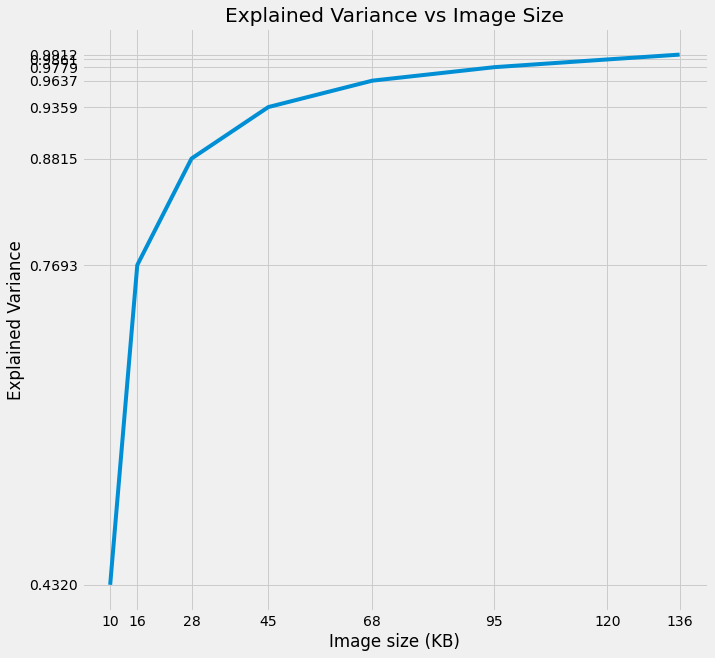

In [24]:
#Plotting the tradeoff between Explained Variance and Image Size
plt.figure(figsize=(10,10))
plt.plot(compd_img3D_size_1,sil_score_1)
plt.xticks(compd_img3D_size_1)
plt.yticks(sil_score_1)
plt.xlabel('Image size (KB)')
plt.ylabel('Explained Variance')
plt.title('Explained Variance vs Image Size', )
plt.show()

In [25]:
#Calculating optimal elbow by comparing Explained Variance and Image Size 
def elbow_size(var_arr, size_arr):
    begin = (var_arr[0], size_arr[0])
    end = (var_arr[-1], size_arr[-1])

    m = (end[1] - begin[1]) / (end[0] - begin[0])
    c = (end[1]- (m*end[0]))

    dist = []
    for i in range(1,9):
        dist.append(abs(m*var_arr[i-1] - size_arr[i-1] + c) / math.sqrt(m**2 + 1))
    return 2**(dist.index(max(dist)) + 1)


In [26]:
#Calculating optimal elbow for each metrics

w1 = elbow_sse(wcss_1)
b1 = elbow_sse(bcss_1)
s1 = elbow_sse(sil_score_1)
el1 = elbow_size(sil_score_1, compd_img3D_size_1)

print("Optimal elbow for WCCS : ", w1, "clusters")
print("Optimal elbow for BCSS : ", b1, "clusters")
print("Optimal elbow for Explained Variance : ", s1, "clusters")
print("Optimal elbow for Explained Variance and Image Size : ", el1, "clusters")

Optimal elbow for WCCS :  16 clusters
Optimal elbow for BCSS :  16 clusters
Optimal elbow for Explained Variance :  16 clusters
Optimal elbow for Explained Variance and Image Size :  8 clusters


<Figure size 432x288 with 0 Axes>

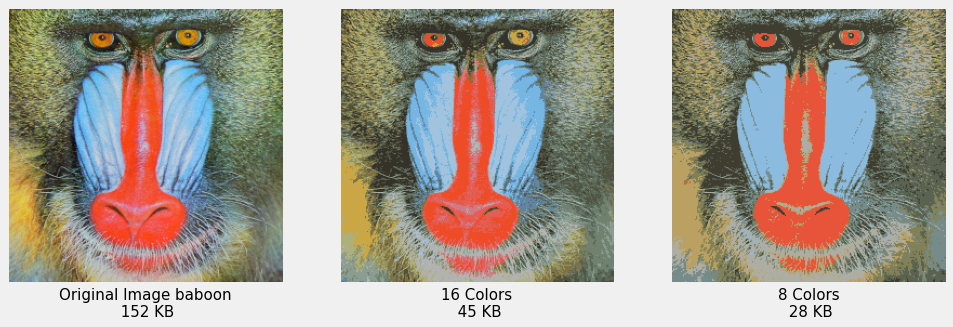

In [27]:
plt.figure()
f, axarr = plt.subplots(1,3, figsize=(15,30)) 
axarr[0].imshow(images[0])
axarr[0].set_xticks([])
axarr[0].set_yticks([])
axarr[0].set_xlabel(f"Original Image {image_names[0]}\n {int(orig_size[0])} KB", fontsize=15)

compressed = Image.fromarray(compd_img3D_1[int(math.log(w1, 2)) - 1])
axarr[1].imshow(compressed)
axarr[1].set_xticks([])
axarr[1].set_yticks([])
axarr[1].set_xlabel(f"{w1} Colors\n {compd_img3D_size_1[int(math.log(w1, 2)) - 1]} KB", fontsize=15)

compressed = Image.fromarray(compd_img3D_1[int(math.log(el1, 2)) - 1])
axarr[2].imshow(compressed)
axarr[2].set_xticks([])
axarr[2].set_yticks([])
axarr[2].set_xlabel(f"{el1} Colors\n {compd_img3D_size_1[int(math.log(el1, 2)) - 1]} KB", fontsize=15)
plt.show()

In [28]:
#Initiating K-Means for Image 2 - Landspace
kmeans_arr_2 = [] 

for i in range(1,9):
    kmeans_arr_2.append(kmeans_loop(reshaped_images[1], 2**i))


In [29]:
#Converting each pixel to its centroids
compd_img_2 = []
compd_img3D_2 = []
compd_img3D_size_2 = []

for kmeans in kmeans_arr_2:
    compd_img3D_2.append(pixels_as_centroids(kmeans, True, True))
    compd_img_2.append(pixels_as_centroids(kmeans, False, False))
#Calculating size for each compressed image
for image in compd_img3D_2:
    compd_img3D_size_2.append(int(image_size(image)))

In [30]:
#Calculating Metrics for Image 2
wcss_2 = []
bcss_2 = []
sil_score_2 = []

for i in range(8):
    wcss_2.append(wcss(compd_img_2[i], reshaped_images[1]))
    bcss_2.append(bcss(kmeans_arr_2[i], reshaped_images[1]))
    sil_score_2.append(bcss_2[i] / (wcss_2[i] + bcss_2[i]))

In [31]:
colors_2 = []

for i in range(8):
    colors = [] 
    for center in kmeans_arr_2[i].cluster_centers_:
        colors.append(get_colour_name(center.tolist()))
    colors_2.append(colors)

In [32]:
#Constructing a data frame for metric for each compressed image

data_2 = []

for i in range(8):
    data_2.append([len(kmeans_arr_2[i].cluster_centers_), colors_2[i], wcss_2[i], bcss_2[i], sil_score_2[i], compd_img3D_size_2[i]])
df = pd.DataFrame(data_2, columns = cols)

df

,# Clusters,Used Color Names,WCSS,BCSS,Explained Variance,Image Size (KB)
0,2,"[darkslategray, silver]",2.020627e+08,5.292746e+08,0.723708,3
1,4,"[thistle, darkslategray, lightslategray, slate...",5.972480e+07,6.705896e+08,0.918220,6
2,8,"[darkgray, darkslategray, slategray, lightslat...",3.082039e+07,7.003865e+08,0.957850,15
3,16,"[thistle, darkslategray, slategray, thistle, l...",1.449785e+07,7.156529e+08,0.980144,21
4,32,"[darkslategray, darkgray, dimgray, darkslategr...",7.310318e+06,7.234333e+08,0.989996,33
5,64,"[steelblue, lightsteelblue, darkslategray, lig...",3.876811e+06,7.269368e+08,0.994695,45
6,128,"[thistle, darkslategray, slategray, darkgray, ...",2.182997e+06,7.287130e+08,0.997013,59
7,256,"[thistle, darkslategray, gray, lightslategray,...",1.291899e+06,7.296323e+08,0.998233,71


<Figure size 432x288 with 0 Axes>

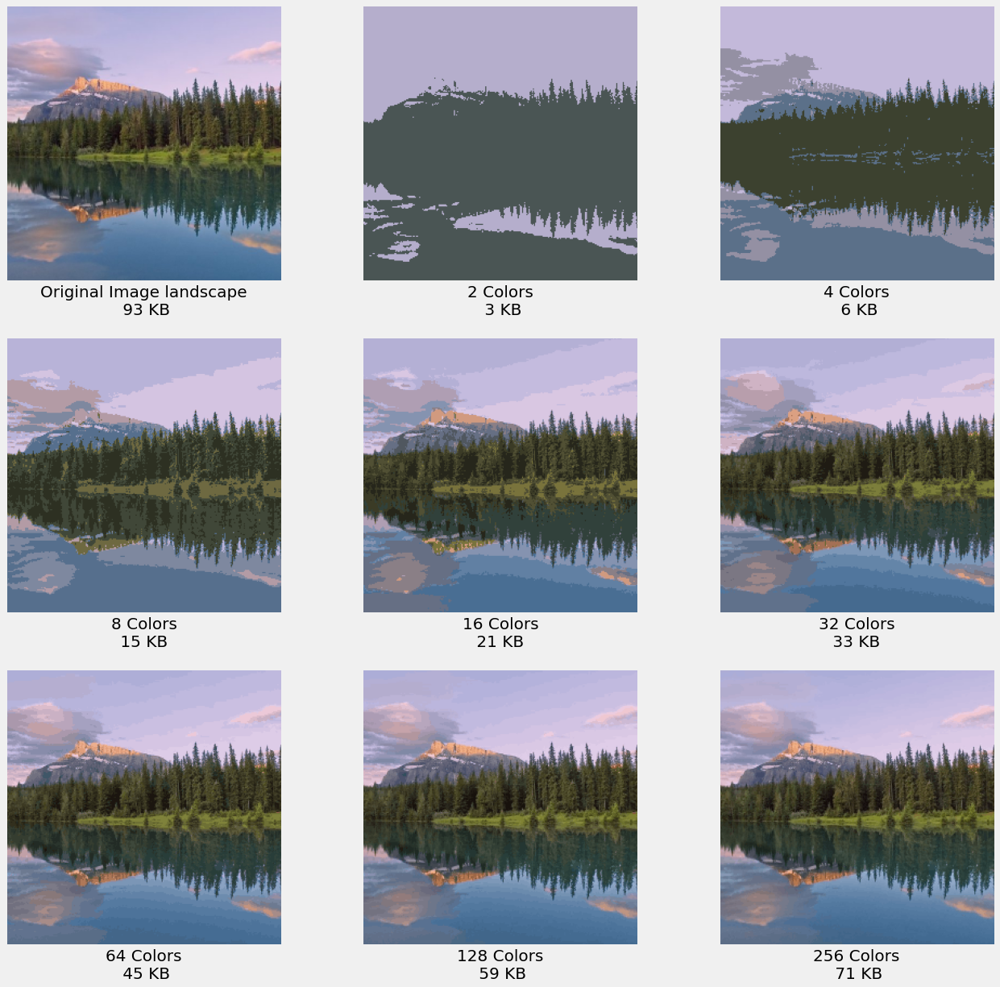

In [33]:
plt.figure()
plt.style.use("fivethirtyeight")

f, axarr = plt.subplots(3,3, figsize=(20,20)) 
axarr[0][0].imshow(images[1])
axarr[0][0].set_xticks([])
axarr[0][0].set_yticks([])
axarr[0][0].set_xlabel(f"Original Image {image_names[1]}\n {int(orig_size[1])} KB", fontsize=20)

for j in range(1,3):
    compressed = Image.fromarray(compd_img3D_2[j-1])

    axarr[0][j].imshow(compressed)
    axarr[0][j].set_xticks([])
    axarr[0][j].set_yticks([])
    axarr[0][j].set_xlabel(f"{2**j} Colors\n {compd_img3D_size_2[j-1]} KB", fontsize=20)

for k in range (3,6):
    compressed = Image.fromarray(compd_img3D_2[k-1])
 
    axarr[1][k-3].imshow(compressed)
    axarr[1][k-3].set_xticks([])
    axarr[1][k-3].set_yticks([])
    axarr[1][k-3].set_xlabel(f"{2**k} Colors\n {compd_img3D_size_2[k-1]} KB ", fontsize=20)

for l in range(6,9):
    compressed = Image.fromarray(compd_img3D_2[l-1])

    axarr[2][l-6].imshow(compressed)
    axarr[2][l-6].set_xticks([])
    axarr[2][l-6].set_yticks([])
    axarr[2][l-6].set_xlabel(f"{2**l} Colors\n {compd_img3D_size_2[l-1]} KB", fontsize=20)

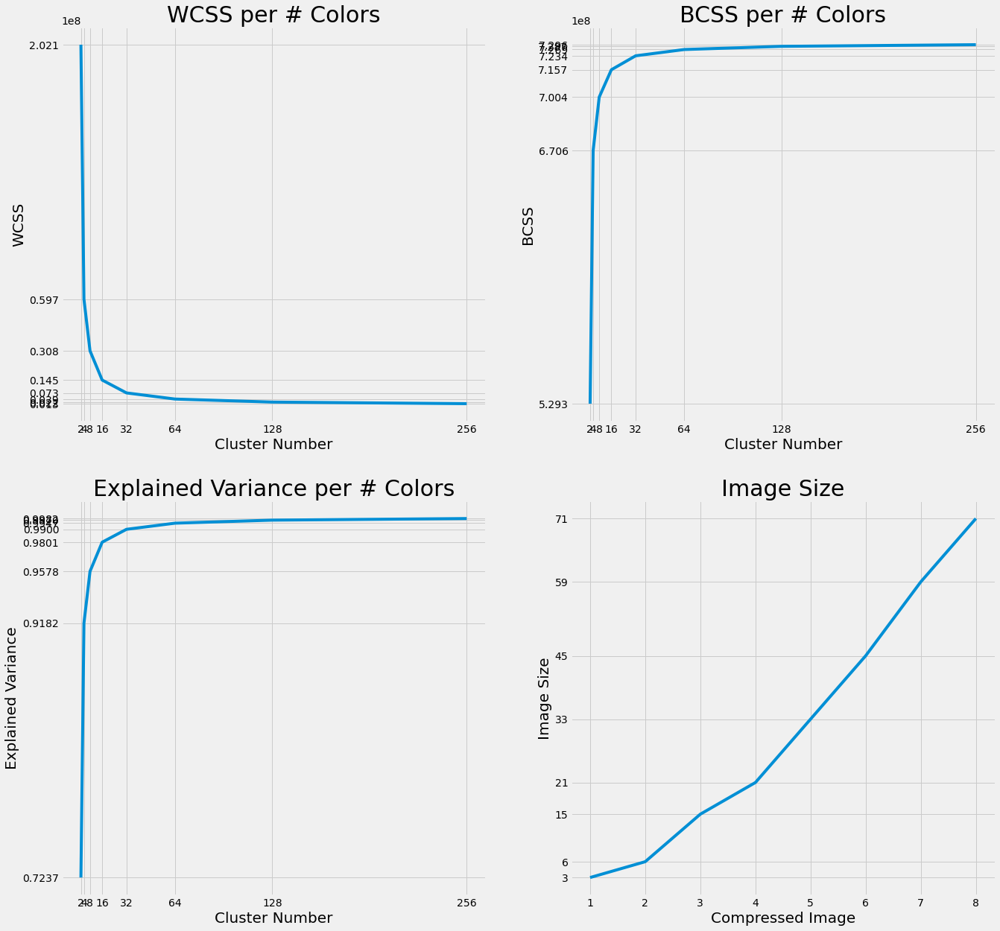

In [34]:
#Plotting Metrics for landscape (WCSS, BCSS, Explained Variance, Image Size)
plt.style.use("fivethirtyeight")

f, axarr = plt.subplots(2,2, figsize=(20,20)) 

squared = []
for i in range(1,9):
    squared.append(2**i)
axarr[0][0].plot(squared, wcss_2)
axarr[0][0].set_xticks(squared)
axarr[0][0].set_yticks(wcss_2)
axarr[0][0].set_title("WCSS per # Colors", fontsize=30)
axarr[0][0].set_xlabel("Cluster Number", fontsize=20)
axarr[0][0].set_ylabel("WCSS", fontsize=20)
axarr[0][1].plot(squared, bcss_2)
axarr[0][1].set_xticks(squared)
axarr[0][1].set_yticks(bcss_2)
axarr[0][1].set_title("BCSS per # Colors", fontsize=30)
axarr[0][1].set_xlabel("Cluster Number", fontsize=20)
axarr[0][1].set_ylabel("BCSS", fontsize=20)
axarr[1][0].plot(squared, sil_score_2)
axarr[1][0].set_xticks(squared)
axarr[1][0].set_yticks(sil_score_2)
axarr[1][0].set_title("Explained Variance per # Colors", fontsize=30)
axarr[1][0].set_xlabel("Cluster Number", fontsize=20)
axarr[1][0].set_ylabel("Explained Variance", fontsize=20)
axarr[1][1].plot(range(1,9), compd_img3D_size_2)
axarr[1][1].set_xticks(range(1,9))
axarr[1][1].set_yticks(compd_img3D_size_2)
axarr[1][1].set_title("Image Size", fontsize=30)
axarr[1][1].set_xlabel("Compressed Image", fontsize=20)
axarr[1][1].set_ylabel("Image Size", fontsize=20)
plt.show()

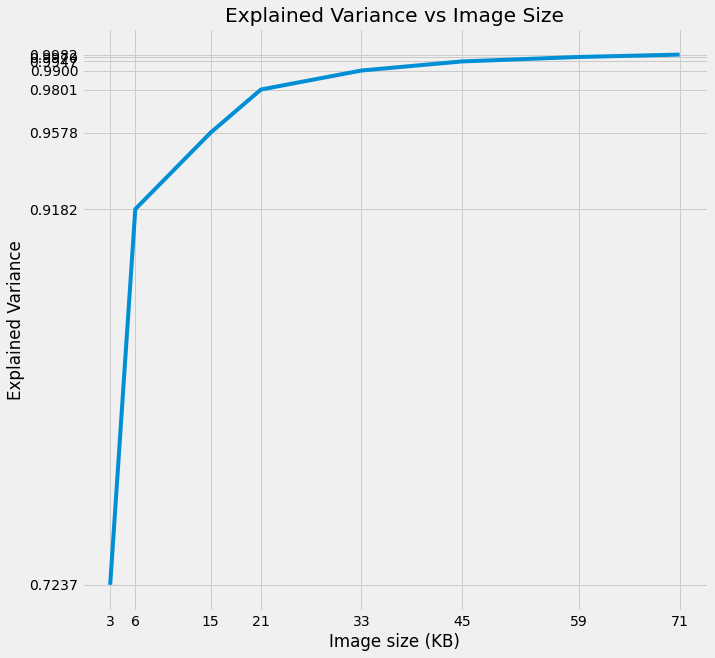

In [35]:
#Plotting the tradeoff between Explained Variance and Image Size
plt.figure(figsize=(10,10))
plt.plot(compd_img3D_size_2,sil_score_2)
plt.xticks(compd_img3D_size_2)
plt.yticks(sil_score_2)
plt.xlabel('Image size (KB)')
plt.ylabel('Explained Variance')
plt.title('Explained Variance vs Image Size')
plt.show()

In [36]:
w2 = elbow_sse(wcss_2)
b2 = elbow_sse(bcss_2)
s2 = elbow_sse(sil_score_2)
el2 = elbow_size(sil_score_2, compd_img3D_size_2)

print("Optimal elbow for WCCS : ", w2, "clusters")
print("Optimal elbow for BCSS : ", b2, "clusters")
print("Optimal elbow for Explained Variance : ", s2, "clusters")
print("Optimal elbow for Explained Variance and Image Size : ", el2, "clusters")

Optimal elbow for WCCS :  16 clusters
Optimal elbow for BCSS :  16 clusters
Optimal elbow for Explained Variance :  16 clusters
Optimal elbow for Explained Variance and Image Size :  8 clusters


<Figure size 432x288 with 0 Axes>

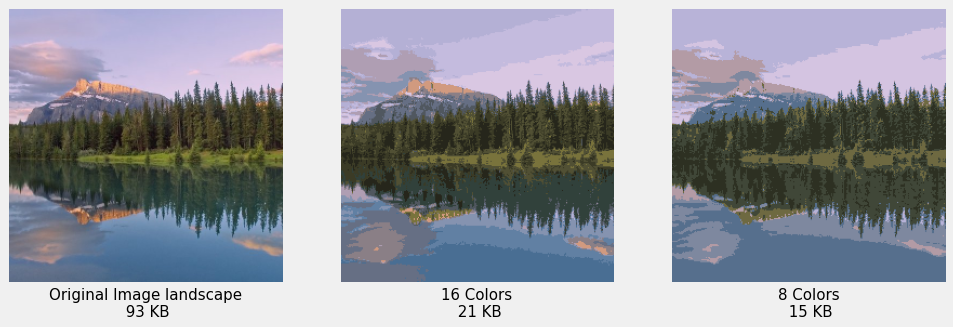

In [37]:
plt.figure()
f, axarr = plt.subplots(1,3, figsize=(15,30)) 
axarr[0].imshow(images[1])
axarr[0].set_xticks([])
axarr[0].set_yticks([])
axarr[0].set_xlabel(f"Original Image {image_names[1]}\n {int(orig_size[1])} KB", fontsize=15)

compressed = Image.fromarray(compd_img3D_2[int(math.log(w2, 2)) - 1])
axarr[1].imshow(compressed)
axarr[1].set_xticks([])
axarr[1].set_yticks([])
axarr[1].set_xlabel(f"{w2} Colors\n {compd_img3D_size_2[int(math.log(w2, 2)) - 1]} KB", fontsize=15)

compressed = Image.fromarray(compd_img3D_2[int(math.log(el2, 2)) - 1])
axarr[2].imshow(compressed)
axarr[2].set_xticks([])
axarr[2].set_yticks([])
axarr[2].set_xlabel(f"{el2} Colors\n {compd_img3D_size_2[int(math.log(el2, 2)) - 1]} KB", fontsize=15)
plt.show()

In [38]:
kmeans_arr_3 = [] 

for i in range(1,9):
    kmeans_arr_3.append(kmeans_loop(reshaped_images[2], 2**i))

In [39]:
compd_img_3 = []
compd_img3D_3 = []
compd_img3D_size_3 = []

for kmeans in kmeans_arr_3:
    compd_img3D_3.append(pixels_as_centroids(kmeans, True, True))
    compd_img_3.append(pixels_as_centroids(kmeans, False, False))

for image in compd_img3D_3:
    compd_img3D_size_3.append(int(image_size(image)))

In [40]:
wcss_3 = []
bcss_3 = []
sil_score_3 = []

for i in range(8):
    wcss_3.append(wcss(compd_img_3[i], reshaped_images[2]))
    bcss_3.append(bcss(kmeans_arr_3[i], reshaped_images[2]))
    sil_score_3.append(bcss_3[i] / (wcss_3[i] + bcss_3[i]))

In [41]:
colors_3 = []

for i in range(8):
    colors = [] 
    for center in kmeans_arr_3[i].cluster_centers_:
        colors.append(get_colour_name(center.tolist()))
    colors_3.append(colors)

In [42]:
#Constructing a data frame for metric for each compressed image

data_3 = []

for i in range(8):
    data_3.append([len(kmeans_arr_3[i].cluster_centers_), colors_3[i], wcss_3[i], bcss_3[i], sil_score_3[i], compd_img3D_size_3[i]])
df = pd.DataFrame(data_3, columns = cols)

df

,# Clusters,Used Color Names,WCSS,BCSS,Explained Variance,Image Size (KB)
0,2,"[darksalmon, brown]",1.469500e+08,2.603398e+08,0.639200,5
1,4,"[indianred, lightcoral, brown, burlywood]",5.153359e+07,3.562150e+08,0.873614,11
2,8,"[wheat, sienna, gray, darksalmon, indigo, ligh...",2.452743e+07,3.824505e+08,0.939733,19
3,16,"[indigo, indianred, burlywood, brown, rosybrow...",1.229589e+07,3.944226e+08,0.969768,28
4,32,"[indigo, indianred, burlywood, darksalmon, sie...",6.604994e+06,4.004146e+08,0.983772,44
5,64,"[tan, sienna, darksalmon, indianred, brown, in...",3.844411e+06,4.031926e+08,0.990555,63
6,128,"[silver, sienna, darksalmon, indianred, brown,...",2.375125e+06,4.046978e+08,0.994165,81
7,256,"[indianred, brown, burlywood, brown, rosybrown...",1.497101e+06,4.055992e+08,0.996322,96


<Figure size 432x288 with 0 Axes>

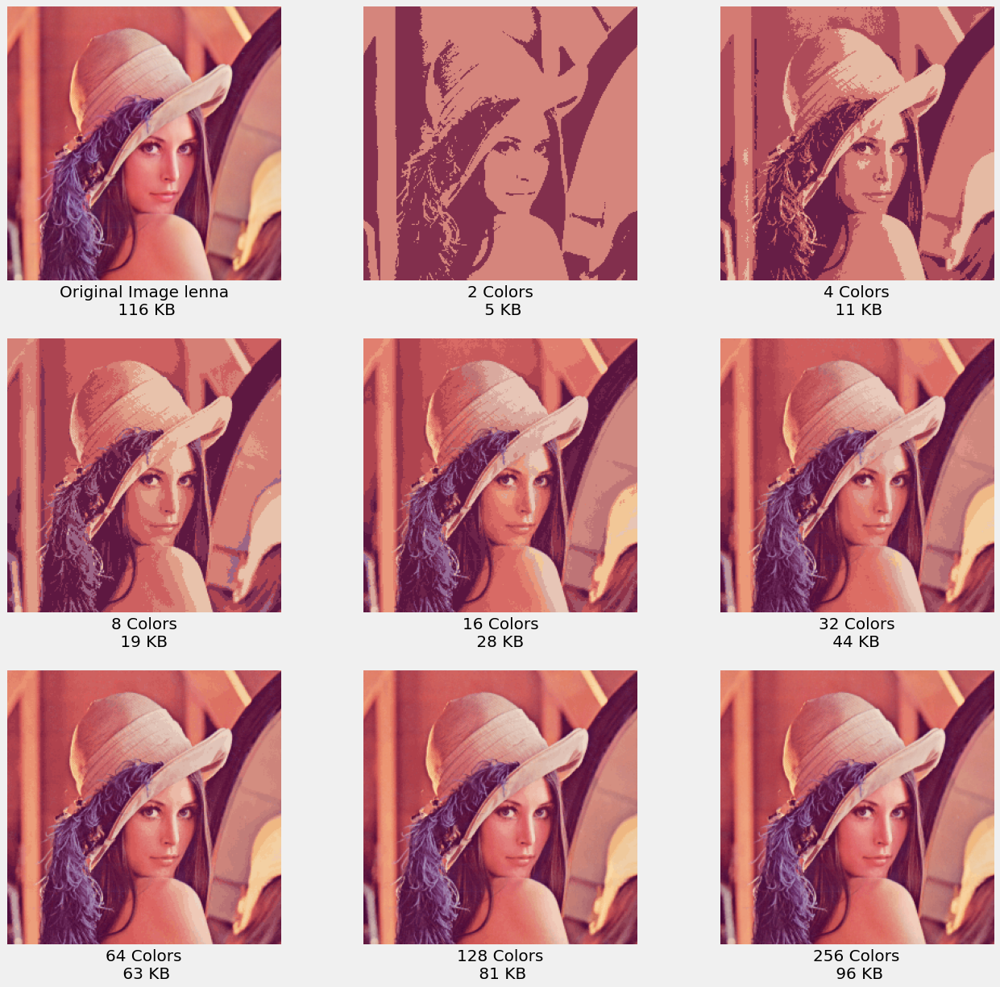

In [43]:
plt.figure()
f, axarr = plt.subplots(3,3, figsize=(20,20)) 
axarr[0][0].imshow(images[2])
axarr[0][0].set_xticks([])
axarr[0][0].set_yticks([])
axarr[0][0].set_xlabel(f"Original Image {image_names[2]}\n {int(orig_size[2])} KB", fontsize=20)


for j in range(1,3):
    compressed = Image.fromarray(compd_img3D_3[j-1])

    axarr[0][j].imshow(compressed)
    axarr[0][j].set_xticks([])
    axarr[0][j].set_yticks([])
    axarr[0][j].set_xlabel(f"{2**j} Colors\n {compd_img3D_size_3[j-1]} KB", fontsize=20)

for k in range (3,6):
    compressed = Image.fromarray(compd_img3D_3[k-1])

    axarr[1][k-3].imshow(compressed)
    axarr[1][k-3].set_xticks([])
    axarr[1][k-3].set_yticks([])
    axarr[1][k-3].set_xlabel(f"{2**k} Colors\n {compd_img3D_size_3[k-1]} KB ", fontsize=20)

for l in range(6,9):
    compressed = Image.fromarray(compd_img3D_3[l-1])

    axarr[2][l-6].imshow(compressed)
    axarr[2][l-6].set_xticks([])
    axarr[2][l-6].set_yticks([])
    axarr[2][l-6].set_xlabel(f"{2**l} Colors\n {compd_img3D_size_3[l-1]} KB", fontsize=20)

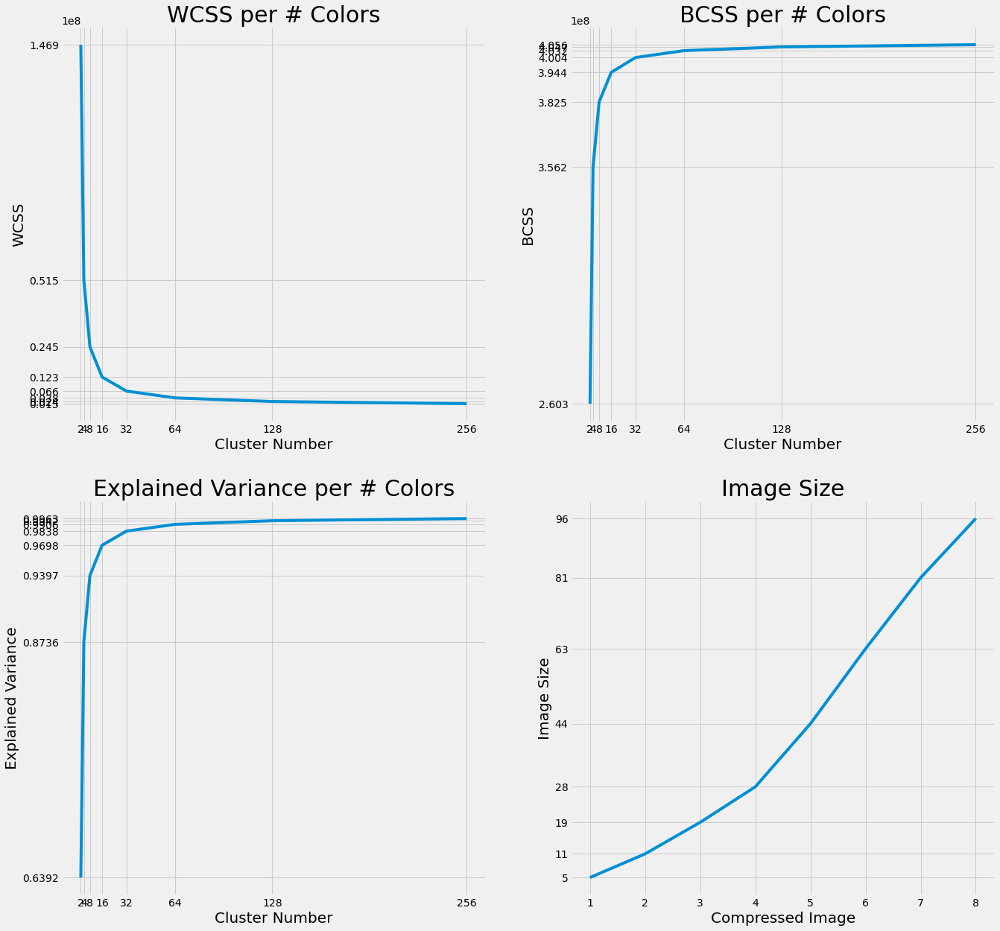

In [44]:
#Plotting Metrics for lenna (WCSS, BCSS, Explained Variance, Image Size)
plt.style.use("fivethirtyeight")

f, axarr = plt.subplots(2,2, figsize=(20,20)) 

squared = []
for i in range(1,9):
    squared.append(2**i)
axarr[0][0].plot(squared, wcss_3)
axarr[0][0].set_xticks(squared)
axarr[0][0].set_yticks(wcss_3)
axarr[0][0].set_title("WCSS per # Colors", fontsize=30)
axarr[0][0].set_xlabel("Cluster Number", fontsize=20)
axarr[0][0].set_ylabel("WCSS", fontsize=20)
axarr[0][1].plot(squared, bcss_3)
axarr[0][1].set_xticks(squared)
axarr[0][1].set_yticks(bcss_3)
axarr[0][1].set_title("BCSS per # Colors", fontsize=30)
axarr[0][1].set_xlabel("Cluster Number", fontsize=20)
axarr[0][1].set_ylabel("BCSS", fontsize=20)
axarr[1][0].plot(squared, sil_score_3)
axarr[1][0].set_xticks(squared)
axarr[1][0].set_yticks(sil_score_3)
axarr[1][0].set_title("Explained Variance per # Colors", fontsize=30)
axarr[1][0].set_xlabel("Cluster Number", fontsize=20)
axarr[1][0].set_ylabel("Explained Variance", fontsize=20)
axarr[1][1].plot(range(1,9), compd_img3D_size_3)
axarr[1][1].set_xticks(range(1,9))
axarr[1][1].set_yticks(compd_img3D_size_3)
axarr[1][1].set_title("Image Size", fontsize=30)
axarr[1][1].set_xlabel("Compressed Image", fontsize=20)
axarr[1][1].set_ylabel("Image Size", fontsize=20)
plt.show()

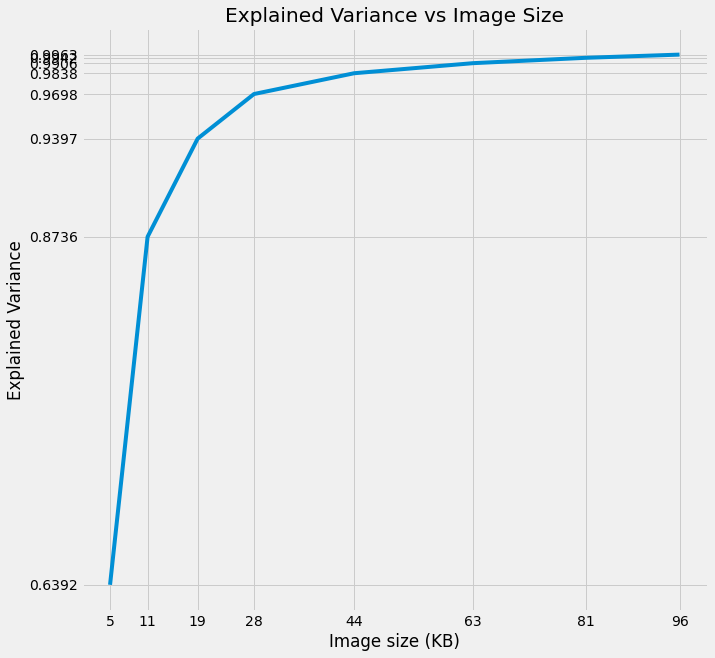

In [45]:
#Plotting the tradeoff between Explained Variance and Image Size
plt.figure(figsize=(10,10))
plt.plot(compd_img3D_size_3,sil_score_3)
plt.xticks(compd_img3D_size_3)
plt.yticks(sil_score_3)
plt.xlabel('Image size (KB)')
plt.ylabel('Explained Variance')
plt.title('Explained Variance vs Image Size', )
plt.show()

In [46]:
w3 = elbow_sse(wcss_3)
b3 = elbow_sse(bcss_3)
s3 = elbow_sse(sil_score_3)
el3 = elbow_size(sil_score_3, compd_img3D_size_3)

print("Optimal elbow for WCCS : ", w3, "clusters")
print("Optimal elbow for BCSS : ", b3, "clusters")
print("Optimal elbow for Explained Variance : ", s3, "clusters")
print("Optimal elbow for Explained Variance and Image Size : ", el3, "clusters")

Optimal elbow for WCCS :  16 clusters
Optimal elbow for BCSS :  16 clusters
Optimal elbow for Explained Variance :  16 clusters
Optimal elbow for Explained Variance and Image Size :  8 clusters


<Figure size 432x288 with 0 Axes>

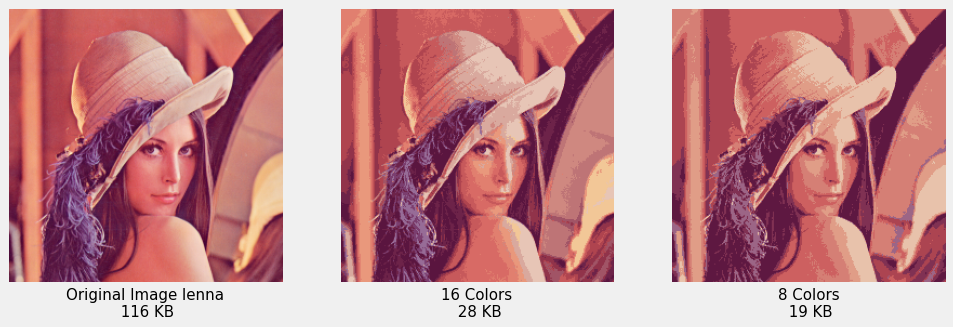

In [47]:
plt.figure()
f, axarr = plt.subplots(1,3, figsize=(15,30)) 
axarr[0].imshow(images[2])
axarr[0].set_xticks([])
axarr[0].set_yticks([])
axarr[0].set_xlabel(f"Original Image {image_names[2]}\n {int(orig_size[2])} KB", fontsize=15)

compressed = Image.fromarray(compd_img3D_3[int(math.log(w3, 2)) - 1])
axarr[1].imshow(compressed)
axarr[1].set_xticks([])
axarr[1].set_yticks([])
axarr[1].set_xlabel(f"{w3} Colors\n {compd_img3D_size_3[int(math.log(w3, 2)) - 1]} KB", fontsize=15)

compressed = Image.fromarray(compd_img3D_3[int(math.log(el3, 2)) - 1])
axarr[2].imshow(compressed)
axarr[2].set_xticks([])
axarr[2].set_yticks([])
axarr[2].set_xlabel(f"{el3} Colors\n {compd_img3D_size_3[int(math.log(el3, 2)) - 1]} KB", fontsize=15)
plt.show()

In [48]:
kmeans_arr_4 = [] 

for i in range(1,9):
    kmeans_arr_4.append(kmeans_loop(reshaped_images[3], 2**i))

In [49]:
compd_img_4 = []
compd_img3D_4 = []
compd_img3D_size_4 = []

for kmeans in kmeans_arr_4:
    compd_img3D_4.append(pixels_as_centroids(kmeans, True, True))
    compd_img_4.append(pixels_as_centroids(kmeans, False, False))

for image in compd_img3D_4:
    compd_img3D_size_4.append(int(image_size(image)))

In [50]:
wcss_4 = []
bcss_4 = []
sil_score_4 = []

for i in range(8):
    wcss_4.append(wcss(compd_img_4[i], reshaped_images[3]))
    bcss_4.append(bcss(kmeans_arr_4[i], reshaped_images[3]))
    sil_score_4.append(bcss_4[i] / (wcss_4[i] + bcss_4[i]))

In [51]:
colors_4 = []

for i in range(8):
    colors = [] 
    for center in kmeans_arr_4[i].cluster_centers_:
        colors.append(get_colour_name(center.tolist()))
    colors_4.append(colors)

In [52]:
#Constructing a data frame for metric for each compressed image

data_4 = []

for i in range(8):
    data_4.append([len(kmeans_arr_4[i].cluster_centers_), colors_4[i], wcss_4[i], bcss_4[i], sil_score_4[i], compd_img3D_size_4[i]])
df = pd.DataFrame(data_4, columns = cols)

df

,# Clusters,Used Color Names,WCSS,BCSS,Explained Variance,Image Size (KB)
0,2,"[darkkhaki, brown]",2.378420e+08,3.774879e+08,0.613472,4
1,4,"[firebrick, darkkhaki, olivedrab, maroon]",1.049961e+08,5.099873e+08,0.829270,9
2,8,"[yellowgreen, darkolivegreen, black, darkkhaki...",4.435448e+07,5.714637e+08,0.927975,16
3,16,"[olivedrab, firebrick, darkseagreen, maroon, s...",2.380090e+07,5.917762e+08,0.961336,26
4,32,"[firebrick, olivedrab, saddlebrown, darkkhaki,...",1.361877e+07,6.018952e+08,0.977874,39
5,64,"[firebrick, mediumseagreen, maroon, darkkhaki,...",7.674435e+06,6.077740e+08,0.987530,54
6,128,"[darkseagreen, brown, maroon, tan, olivedrab, ...",4.534550e+06,6.108662e+08,0.992632,70
7,256,"[firebrick, mediumseagreen, maroon, darkkhaki,...",2.785762e+06,6.126303e+08,0.995473,88


<Figure size 432x288 with 0 Axes>

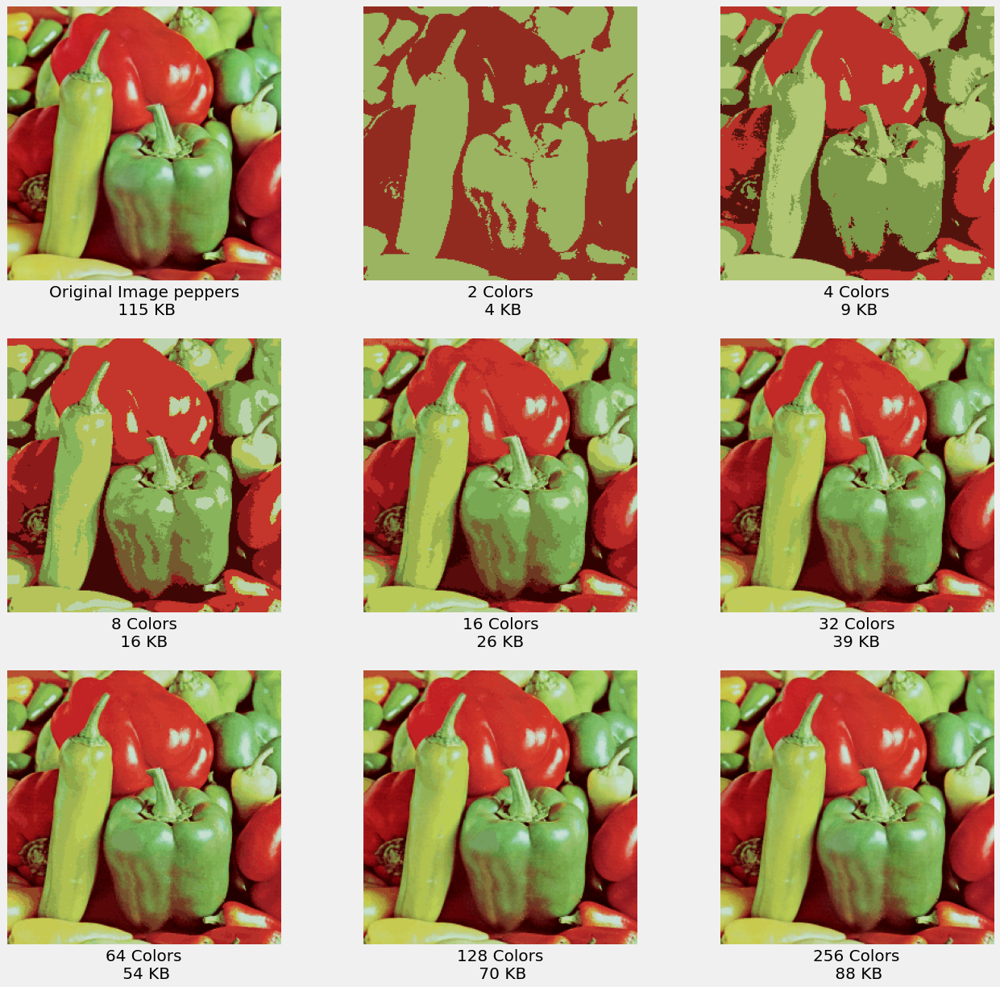

In [53]:
plt.figure()
f, axarr = plt.subplots(3,3, figsize=(20,20)) 
axarr[0][0].imshow(images[3])
axarr[0][0].set_xticks([])
axarr[0][0].set_yticks([])
axarr[0][0].set_xlabel(f"Original Image {image_names[3]}\n {int(orig_size[3])} KB", fontsize=20)


for j in range(1,3):
    compressed = Image.fromarray(compd_img3D_4[j-1])

    axarr[0][j].imshow(compressed)
    axarr[0][j].set_xticks([])
    axarr[0][j].set_yticks([])
    axarr[0][j].set_xlabel(f"{2**j} Colors\n {compd_img3D_size_4[j-1]} KB", fontsize=20)

for k in range (3,6):
    compressed = Image.fromarray(compd_img3D_4[k-1])
 
    axarr[1][k-3].imshow(compressed)
    axarr[1][k-3].set_xticks([])
    axarr[1][k-3].set_yticks([])
    axarr[1][k-3].set_xlabel(f"{2**k} Colors\n {compd_img3D_size_4[k-1]} KB ", fontsize=20)

for l in range(6,9):
    compressed = Image.fromarray(compd_img3D_4[l-1])

    axarr[2][l-6].imshow(compressed)
    axarr[2][l-6].set_xticks([])
    axarr[2][l-6].set_yticks([])
    axarr[2][l-6].set_xlabel(f"{2**l} Colors\n {compd_img3D_size_4[l-1]} KB", fontsize=20)

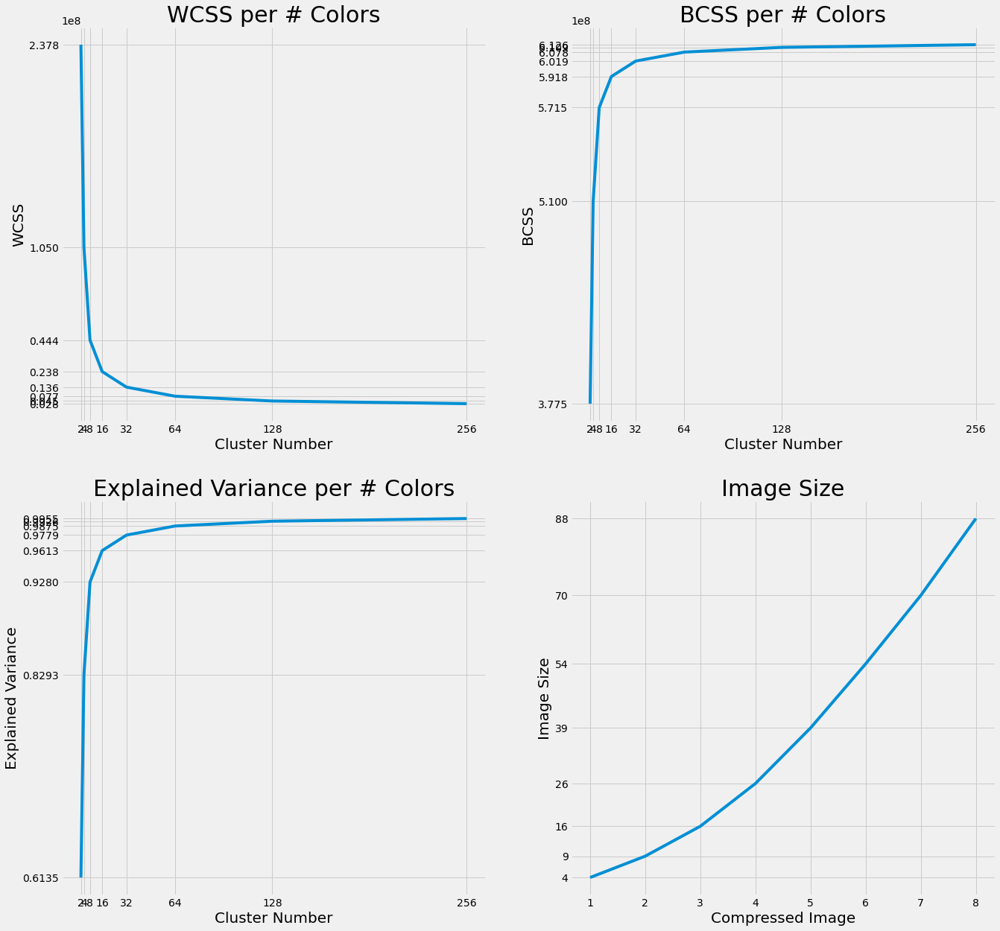

In [54]:
#Plotting Metrics for peppers (WCSS, BCSS, Explained Variance, Image Size)
plt.style.use("fivethirtyeight")

f, axarr = plt.subplots(2,2, figsize=(20,20)) 

squared = []
for i in range(1,9):
    squared.append(2**i)
axarr[0][0].plot(squared, wcss_4)
axarr[0][0].set_xticks(squared)
axarr[0][0].set_yticks(wcss_4)
axarr[0][0].set_title("WCSS per # Colors", fontsize=30)
axarr[0][0].set_xlabel("Cluster Number", fontsize=20)
axarr[0][0].set_ylabel("WCSS", fontsize=20)
axarr[0][1].plot(squared, bcss_4)
axarr[0][1].set_xticks(squared)
axarr[0][1].set_yticks(bcss_4)
axarr[0][1].set_title("BCSS per # Colors", fontsize=30)
axarr[0][1].set_xlabel("Cluster Number", fontsize=20)
axarr[0][1].set_ylabel("BCSS", fontsize=20)
axarr[1][0].plot(squared, sil_score_4)
axarr[1][0].set_xticks(squared)
axarr[1][0].set_yticks(sil_score_4)
axarr[1][0].set_title("Explained Variance per # Colors", fontsize=30)
axarr[1][0].set_xlabel("Cluster Number", fontsize=20)
axarr[1][0].set_ylabel("Explained Variance", fontsize=20)
axarr[1][1].plot(range(1,9), compd_img3D_size_4)
axarr[1][1].set_xticks(range(1,9))
axarr[1][1].set_yticks(compd_img3D_size_4)
axarr[1][1].set_title("Image Size", fontsize=30)
axarr[1][1].set_xlabel("Compressed Image", fontsize=20)
axarr[1][1].set_ylabel("Image Size", fontsize=20)
plt.show()

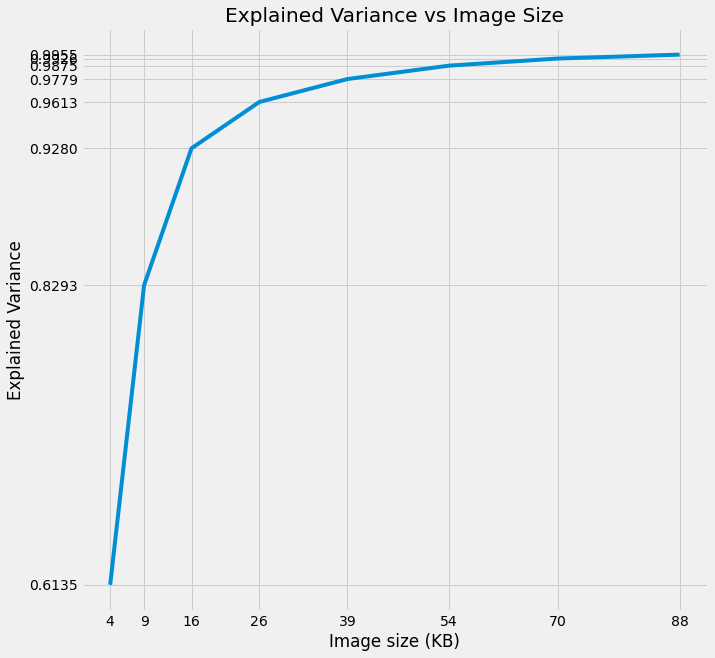

In [55]:
#Plotting the tradeoff between Explained Variance and Image Size
plt.figure(figsize=(10,10))
plt.plot(compd_img3D_size_4,sil_score_4)
plt.xticks(compd_img3D_size_4)
plt.yticks(sil_score_4)
plt.xlabel('Image size (KB)')
plt.ylabel('Explained Variance')
plt.title('Explained Variance vs Image Size', )
plt.show()

In [56]:
w4 = elbow_sse(wcss_4)
b4 = elbow_sse(bcss_4)
s4 = elbow_sse(sil_score_4)
el4 = elbow_size(sil_score_4, compd_img3D_size_4)

print("Optimal elbow for WCCS : ", w4, "clusters")
print("Optimal elbow for BCSS : ", b4, "clusters")
print("Optimal elbow for Explained Variance : ", s4, "clusters")
print("Optimal elbow for Explained Variance and Image Size : ", el4, "clusters")

Optimal elbow for WCCS :  16 clusters
Optimal elbow for BCSS :  16 clusters
Optimal elbow for Explained Variance :  16 clusters
Optimal elbow for Explained Variance and Image Size :  8 clusters


<Figure size 432x288 with 0 Axes>

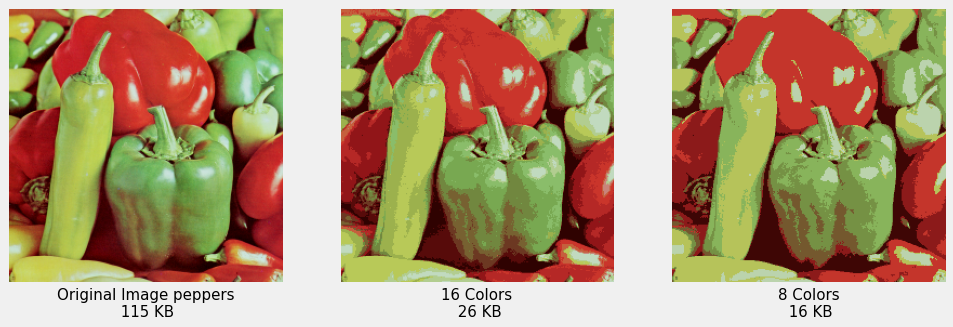

In [57]:
plt.figure()
f, axarr = plt.subplots(1,3, figsize=(15,30)) 
axarr[0].imshow(images[3])
axarr[0].set_xticks([])
axarr[0].set_yticks([])
axarr[0].set_xlabel(f"Original Image {image_names[3]}\n {int(orig_size[3])} KB", fontsize=15)

compressed = Image.fromarray(compd_img3D_4[int(math.log(w4, 2)) - 1])
axarr[1].imshow(compressed)
axarr[1].set_xticks([])
axarr[1].set_yticks([])
axarr[1].set_xlabel(f"{w4} Colors\n {compd_img3D_size_4[int(math.log(w4, 2)) - 1]} KB", fontsize=15)

compressed = Image.fromarray(compd_img3D_4[int(math.log(el4, 2)) - 1])
axarr[2].imshow(compressed)
axarr[2].set_xticks([])
axarr[2].set_yticks([])
axarr[2].set_xlabel(f"{el4} Colors\n {compd_img3D_size_4[int(math.log(el4, 2)) - 1]} KB", fontsize=15)
plt.show()

In [58]:
kmeans_arr_5 = [] 

for i in range(1,9):
    kmeans_arr_5.append(kmeans_loop(reshaped_images[4], 2**i))

In [59]:
compd_img_5 = []
compd_img3D_5 = []
compd_img3D_size_5 = []

for kmeans in kmeans_arr_5:
    compd_img3D_5.append(pixels_as_centroids(kmeans, True, True))

for kmeans in kmeans_arr_5:
    compd_img_5.append(pixels_as_centroids(kmeans, False, False))

for image in compd_img3D_5:
    compd_img3D_size_5.append(int(image_size(image)))

In [60]:
wcss_5 = []
bcss_5 = []
sil_score_5 = []

for i in range(8):
    wcss_5.append(wcss(compd_img_5[i], reshaped_images[4]))
    bcss_5.append(bcss(kmeans_arr_5[i], reshaped_images[4]))
    sil_score_5.append(bcss_5[i] / (wcss_5[i] + bcss_5[i]))

In [61]:
colors_5 = []

for i in range(8):
    colors = [] 
    for center in kmeans_arr_5[i].cluster_centers_:
        colors.append(get_colour_name(center.tolist()))
    colors_5.append(colors)

In [62]:
#Constructing a data frame for metric for each compressed image

data_5 = []

for i in range(8):
    data_5.append([len(kmeans_arr_2[i].cluster_centers_), colors_5[i], wcss_5[i], bcss_5[i], sil_score_5[i], compd_img3D_size_5[i]])
df = pd.DataFrame(data_5, columns = cols)

df

,# Clusters,Used Color Names,WCSS,BCSS,Explained Variance,Image Size (KB)
0,2,"[tan, brown]",5.946029e+08,6.072108e+08,0.505245,4
1,4,"[darkslategray, peru, red, silver]",2.789862e+08,9.230125e+08,0.767898,9
2,8,"[purple, orange, red, lightgray, tan, black, f...",1.171431e+08,1.085065e+09,0.902560,15
3,16,"[black, burlywood, darkred, indigo, lightblue,...",5.273193e+07,1.147297e+09,0.956058,25
4,32,"[linen, saddlebrown, palevioletred, indigo, bl...",2.692456e+07,1.174032e+09,0.977581,35
5,64,"[lightblue, brown, black, tan, red, orange, di...",1.400055e+07,1.186963e+09,0.988342,50
6,128,"[black, lightsalmon, red, purple, lightblue, g...",7.498503e+06,1.193659e+09,0.993757,64
7,256,"[black, lightsalmon, red, indianred, powderblu...",4.136542e+06,1.196906e+09,0.996556,75


<Figure size 432x288 with 0 Axes>

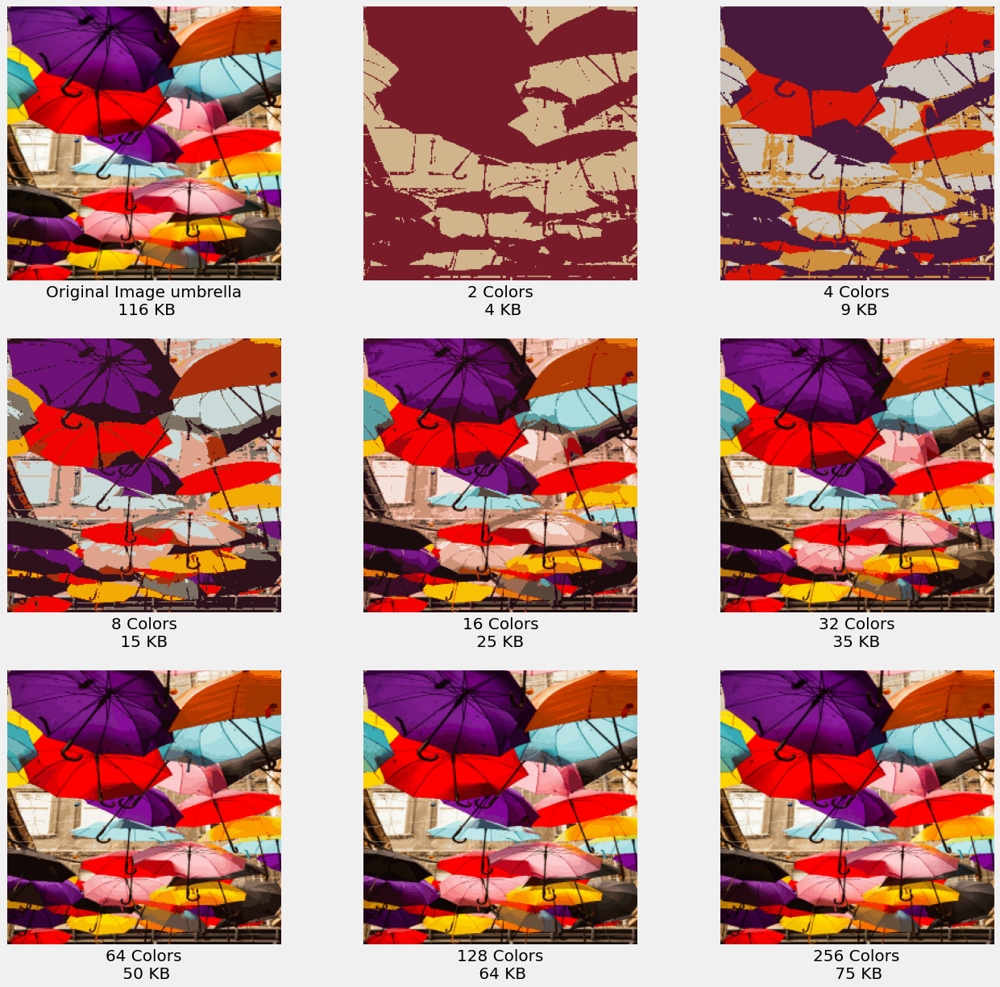

In [63]:
plt.figure()
f, axarr = plt.subplots(3,3, figsize=(20,20)) 
axarr[0][0].imshow(images[4])
axarr[0][0].set_xticks([])
axarr[0][0].set_yticks([])
axarr[0][0].set_xlabel(f"Original Image {image_names[4]}\n {int(orig_size[4])} KB", fontsize=20)


for j in range(1,3):
    compressed = Image.fromarray(compd_img3D_5[j-1])
    # save compressed image
    # display compressed image
    axarr[0][j].imshow(compressed)
    axarr[0][j].set_xticks([])
    axarr[0][j].set_yticks([])
    axarr[0][j].set_xlabel(f"{2**j} Colors\n {compd_img3D_size_5[j-1]} KB", fontsize=20)

for k in range (3,6):
    compressed = Image.fromarray(compd_img3D_5[k-1])
    # save compressed image
    # display compressed image
    axarr[1][k-3].imshow(compressed)
    axarr[1][k-3].set_xticks([])
    axarr[1][k-3].set_yticks([])
    axarr[1][k-3].set_xlabel(f"{2**k} Colors\n {compd_img3D_size_5[k-1]} KB ", fontsize=20)

for l in range(6,9):
    compressed = Image.fromarray(compd_img3D_5[l-1])
    # save compressed image
    # display compressed image
    axarr[2][l-6].imshow(compressed)
    axarr[2][l-6].set_xticks([])
    axarr[2][l-6].set_yticks([])
    axarr[2][l-6].set_xlabel(f"{2**l} Colors\n {compd_img3D_size_5[l-1]} KB", fontsize=20)

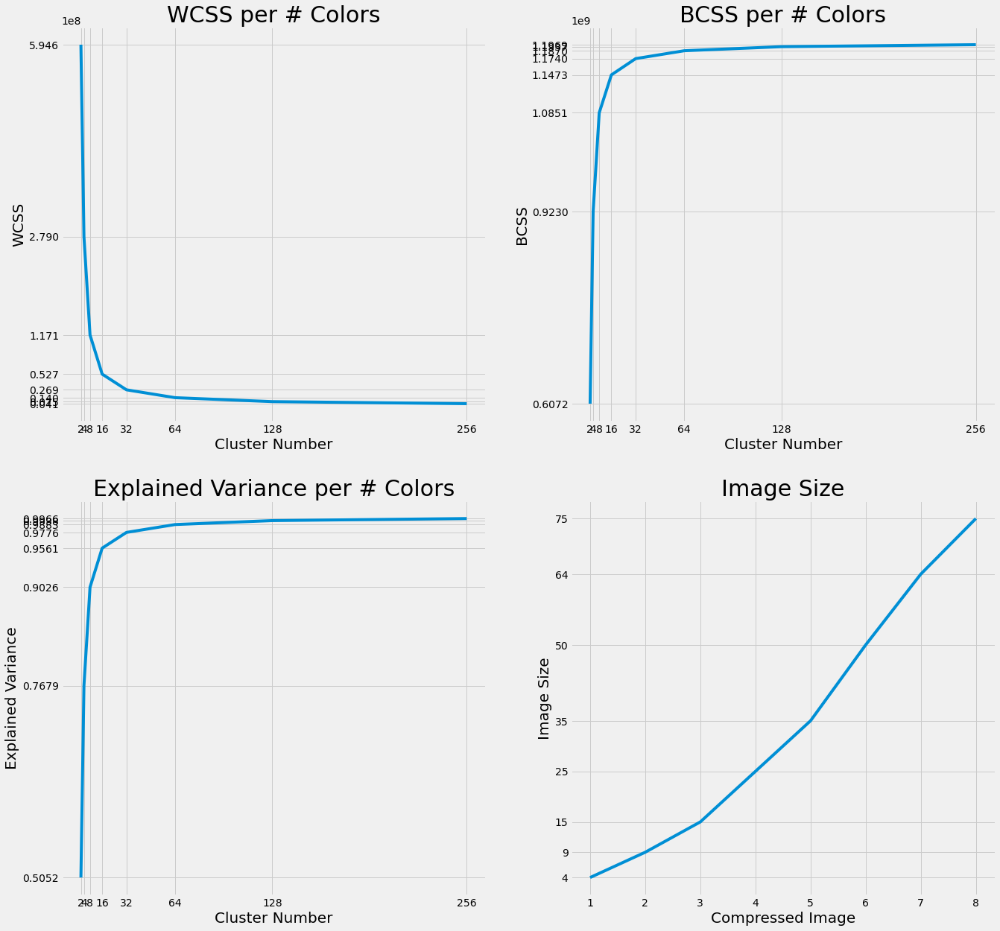

In [64]:
#Plotting Metrics for umbrellas (WCSS, BCSS, Explained Variance, Image Size)
plt.style.use("fivethirtyeight")

f, axarr = plt.subplots(2,2, figsize=(20,20)) 

squared = []
for i in range(1,9):
    squared.append(2**i)
axarr[0][0].plot(squared, wcss_5)
axarr[0][0].set_xticks(squared)
axarr[0][0].set_yticks(wcss_5)
axarr[0][0].set_title("WCSS per # Colors", fontsize=30)
axarr[0][0].set_xlabel("Cluster Number", fontsize=20)
axarr[0][0].set_ylabel("WCSS", fontsize=20)
axarr[0][1].plot(squared, bcss_5)
axarr[0][1].set_xticks(squared)
axarr[0][1].set_yticks(bcss_5)
axarr[0][1].set_title("BCSS per # Colors", fontsize=30)
axarr[0][1].set_xlabel("Cluster Number", fontsize=20)
axarr[0][1].set_ylabel("BCSS", fontsize=20)
axarr[1][0].plot(squared, sil_score_5)
axarr[1][0].set_xticks(squared)
axarr[1][0].set_yticks(sil_score_5)
axarr[1][0].set_title("Explained Variance per # Colors", fontsize=30)
axarr[1][0].set_xlabel("Cluster Number", fontsize=20)
axarr[1][0].set_ylabel("Explained Variance", fontsize=20)
axarr[1][1].plot(range(1,9), compd_img3D_size_5)
axarr[1][1].set_xticks(range(1,9))
axarr[1][1].set_yticks(compd_img3D_size_5)
axarr[1][1].set_title("Image Size", fontsize=30)
axarr[1][1].set_xlabel("Compressed Image", fontsize=20)
axarr[1][1].set_ylabel("Image Size", fontsize=20)
plt.show()

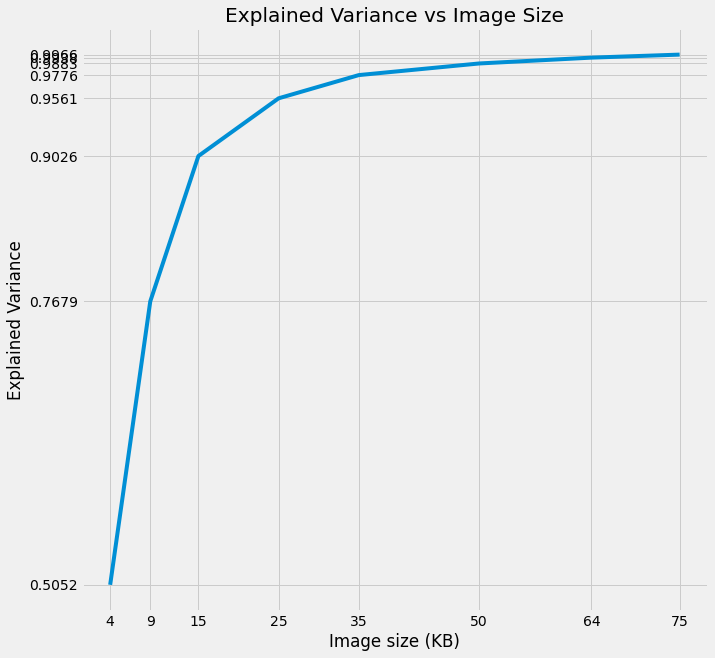

In [65]:
#Plotting the tradeoff between Explained Variance and Image Size
plt.figure(figsize=(10,10))
plt.plot(compd_img3D_size_5,sil_score_5)
plt.xticks(compd_img3D_size_5)
plt.yticks(sil_score_5)
plt.xlabel('Image size (KB)')
plt.ylabel('Explained Variance')
plt.title('Explained Variance vs Image Size', )
plt.show()

In [66]:
w5 = elbow_sse(wcss_5)
b5 = elbow_sse(bcss_5)
s5 = elbow_sse(sil_score_5)
el5 = elbow_size(sil_score_5, compd_img3D_size_5)

print("Optimal elbow for WCCS : ", w5, "clusters")
print("Optimal elbow for BCSS : ", b5, "clusters")
print("Optimal elbow for Explained Variance : ", s5, "clusters")
print("Optimal elbow for Explained Variance and Image Size : ", el5, "clusters")

Optimal elbow for WCCS :  16 clusters
Optimal elbow for BCSS :  16 clusters
Optimal elbow for Explained Variance :  16 clusters
Optimal elbow for Explained Variance and Image Size :  8 clusters


<Figure size 432x288 with 0 Axes>

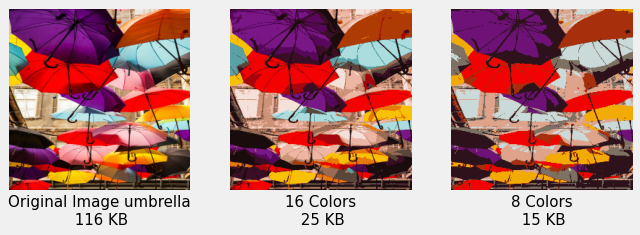

In [67]:
plt.figure()
f, axarr = plt.subplots(1,3, figsize=(10,20)) 
axarr[0].imshow(images[4])
axarr[0].set_xticks([])
axarr[0].set_yticks([])
axarr[0].set_xlabel(f"Original Image {image_names[4]}\n {int(orig_size[4])} KB", fontsize=15)

compressed = Image.fromarray(compd_img3D_5[int(math.log(w5, 2)) - 1])
axarr[1].imshow(compressed)
axarr[1].set_xticks([])
axarr[1].set_yticks([])
axarr[1].set_xlabel(f"{w5} Colors\n {compd_img3D_size_5[int(math.log(w5, 2)) - 1]} KB", fontsize=15)

compressed = Image.fromarray(compd_img3D_5[int(math.log(el5, 2)) - 1])
axarr[2].imshow(compressed)
axarr[2].set_xticks([])
axarr[2].set_yticks([])
axarr[2].set_xlabel(f"{el5} Colors\n {compd_img3D_size_5[int(math.log(el5, 2)) - 1]} KB", fontsize=15)
plt.show()